# Load model

In [1]:
import pycolmap
from pathlib import Path
from hloc.visualization import plot_images, read_image
from hloc.utils import viz_3d
import numpy as np


output_path = Path("../")
image_dir = Path("../../../datasets/great_man/")

import re

def extract_number(filename):
    # 从文件名中提取数字
    match = re.search(r'(\d+)', filename)
    return int(match.group()) if match else 0

# 使用自定义排序键对文件名进行排序
references = sorted([str(p.relative_to(image_dir)) for p in (image_dir/ 'mapping').iterdir()], key=extract_number)

print(len(references), "mapping images")

model = pycolmap.Reconstruction("./")
print(model.summary())

for image_id, image in model.images.items():
    print(image_id, image)
    break

for point3D_id, point3D in model.points3D.items():
    print(point3D_id, point3D)
    break

for camera_id, camera in model.cameras.items():
    print(camera_id, camera.calibration_matrix())
    break

233 mapping images
Reconstruction:
	num_reg_images = 233
	num_cameras = 233
	num_points3D = 105645
	num_observations = 1052643
	mean_track_length = 9.96396
	mean_observations_per_image = 4517.78
	mean_reprojection_error = 1.5189
233 <Image 'image_id=233, camera_id=233, name="mapping/99.jpg", triangulated=4113/5000'>
119800 <Point3D 'xyz=[-0.539963  0.175713   1.83821], track_length=7, error=1.69147'>
233 [[3.3370273e+03 0.0000000e+00 1.0800000e+03]
 [0.0000000e+00 3.3370273e+03 1.9200000e+03]
 [0.0000000e+00 0.0000000e+00 1.0000000e+00]]


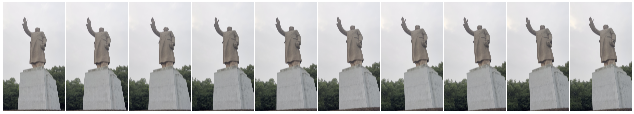

In [2]:
show_imgs = []
for i in range(10):
    show_imgs.append(read_image(image_dir / references[i]))
plot_images(show_imgs, dpi=25)

In [3]:
fig = viz_3d.init_figure()
viz_3d.plot_reconstruction(fig, model, color='rgba(255,0,0,0.5)', name="mapping", points_rgb=True)
fig.show()

In [4]:
image = model.images[1]
print(image)
print(image.name, image.camera_id, image.qvec, image.tvec)

<Image 'image_id=1, camera_id=1, name="mapping/1.jpg", triangulated=4446/5000'>
mapping/1.jpg 1 [ 0.97556217  0.02184181 -0.18732847  0.11273616] [0.51149041 1.71244269 3.01612273]


# Localization

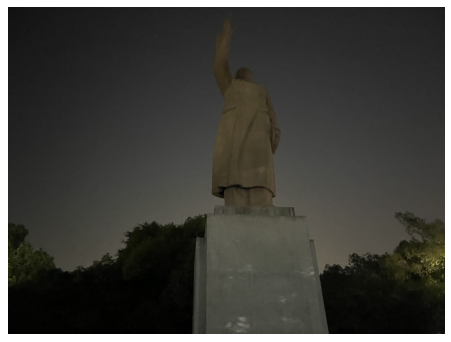

In [5]:
query = 'query/night.jpg'
plot_images([read_image(image_dir / query)], dpi=75)

In [6]:
from hloc import extract_features, match_features, pairs_from_exhaustive, visualization

features = output_path / 'features.h5'
matches = output_path / 'matches.h5'

feature_conf = extract_features.confs['disk']
matcher_conf = match_features.confs['disk+lightglue']
loc_pairs = output_path / 'pairs-loc.txt'

In [7]:
references_registered = [model.images[i].name for i in model.reg_image_ids()]
extract_features.main(feature_conf, image_dir, image_list=[query], feature_path=features, overwrite=True)
pairs_from_exhaustive.main(loc_pairs, image_list=[query], ref_list=references_registered)
match_features.main(matcher_conf, loc_pairs, features=features, matches=matches, overwrite=True)

[2023/12/25 22:33:35 hloc INFO] Extracting local features with configuration:
{'model': {'max_keypoints': 5000, 'name': 'disk'},
 'output': 'feats-disk',
 'preprocessing': {'grayscale': False, 'resize_max': 1600}}
100%|██████████| 1/1 [00:01<00:00,  1.05s/it]
[2023/12/25 22:33:36 hloc INFO] Finished exporting features.
[2023/12/25 22:33:36 hloc INFO] Found 233 pairs.
[2023/12/25 22:33:36 hloc INFO] Matching local features with configuration:
{'model': {'features': 'disk', 'name': 'lightglue'},
 'output': 'matches-disk-lightglue'}
100%|██████████| 233/233 [00:10<00:00, 23.26it/s]
[2023/12/25 22:33:46 hloc INFO] Finished exporting matches.


PosixPath('../matches.h5')

[[2.9952e+03 0.0000e+00 2.0160e+03]
 [0.0000e+00 2.9952e+03 1.5120e+03]
 [0.0000e+00 0.0000e+00 1.0000e+00]]
{'db': [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 1

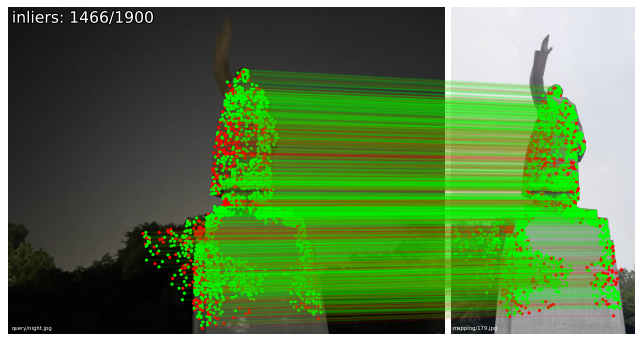

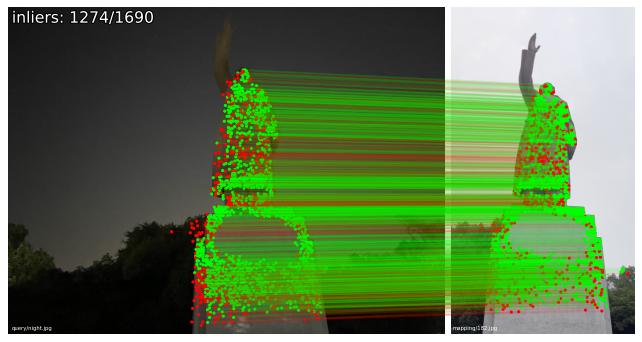

In [8]:
from hloc.localize_sfm import QueryLocalizer, pose_from_cluster

camera = pycolmap.infer_camera_from_image(image_dir / query)
print(camera.calibration_matrix()) # 相机内参矩阵

# 数据库中的参考图像
references_registered = [model.images[i].name for i in model.reg_image_ids()] 
ref_ids = [model.find_image_with_name(n).image_id for n in references_registered]

conf = {
    'estimation': {'ransac': {'max_error': 12}},
    'refinement': {'refine_focal_length': True, 'refine_extra_params': True},
}

localizer = QueryLocalizer(model, conf)
ret, log = pose_from_cluster(localizer, query, camera, ref_ids, features, matches)
print(log)
print(log.keys())
print(f'found {ret["num_inliers"]}/{len(ret["inliers"])} inlier correspondences.')
visualization.visualize_loc_from_log(image_dir, query, log, model)

In [9]:
pose = pycolmap.Image(tvec=ret['tvec'], qvec=ret['qvec'])
print(type(pose), pose)
viz_3d.plot_camera_colmap(fig, pose, camera, color='rgba(0,255,0,0.5)', name=query, fill=True)
inl_3d = np.array([model.points3D[pid].xyz for pid in np.array(log['points3D_ids'])[ret['inliers']]])
viz_3d.plot_points(fig, inl_3d, color="lime", ps=1, name=query)
fig.show()

<class 'pycolmap.Image'> <Image 'image_id=Invalid, camera_id=Invalid, name="", triangulated=0/0'>


(13151, 3)
(13151, 2)
4032 3024


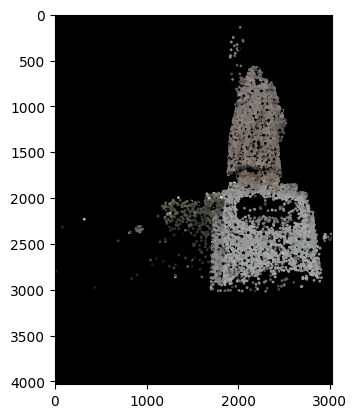

In [17]:
qvec = ret['qvec'] # 旋转向量
tvec = ret['tvec'] # 平移向量
intrinsic = camera.calibration_matrix()
extrinsic = np.eye(4)
# 计算旋转矩阵 R
theta = 2 * np.arccos(qvec[0])  # 角度
axis = qvec[1:] / np.sin(theta/2)  # 轴
R = np.eye(3) * np.cos(theta) + (1 - np.cos(theta)) * np.outer(axis, axis) + np.sin(theta) * np.array([[0, -axis[2], axis[1]], [axis[2], 0, -axis[0]], [-axis[1], axis[0], 0]])

# 构建外参矩阵 P
extrinsic = np.eye(4)
extrinsic[:3, :3] = R
extrinsic[:3, 3] = tvec

# print("外参矩阵 P:")
# print(extrinsic)
# print(intrinsic)

# 所有特征点的点云坐标
inl_3d = np.array([model.points3D[pid].xyz for pid in np.array(log['points3D_ids'])])
# 所有点云的坐标
# inl_3d_ids = [pid for pid in model.points3D]
# inl_3d = np.array([model.points3D[pid].xyz for pid in np.array(inl_3d_ids)])
print(inl_3d.shape)
# 将世界坐标系下的点云转换到相机坐标系下
inl_3d = np.dot(inl_3d, R.T) + tvec
# 将相机坐标系下的点云转换到像素坐标系下
inl_2d = np.dot(inl_3d, intrinsic.T)
# 从齐次坐标转换到非齐次坐标
inl_2d = inl_2d[:, :2] / inl_2d[:, 2:]

print(inl_2d.shape)
# 所有特征点的颜色
inl_3d_color = np.array([model.points3D[pid].color for pid in np.array(log['points3D_ids'])])
# 所有点云的颜色
# inl_3d_color = np.array([model.points3D[pid].color for pid in np.array(inl_3d_ids)])

width = camera.width
height = camera.height
print(width, height)
# 剔除超出图像范围的点云
inl_3d_color = inl_3d_color[(inl_2d[:, 0] >= 0) & (inl_2d[:, 0] < width) & (inl_2d[:, 1] >= 0) & (inl_2d[:, 1] < height)]
inl_2d = inl_2d[(inl_2d[:, 0] >= 0) & (inl_2d[:, 0] < width) & (inl_2d[:, 1] >= 0) & (inl_2d[:, 1] < height)]

# inl_2d_img = np.zeros((width, height, 3))

# inl_2d_img[inl_2d[:, 0].astype(int), inl_2d[:, 1].astype(int)] = inl_3d_color

import matplotlib.pyplot as plt
# plt.figure(figsize=(10, 10))
# plt.subplot(1, 2, 1)
# plt.imshow(inl_2d_img)
plt.scatter(inl_2d[:, 0], inl_2d[:, 1], c=inl_3d_color / 255.0, s=1)
# 设置y轴的方向
plt.gca().invert_yaxis()

plt.imshow(np.zeros((width, height, 3)))
# plt.axis('off')
plt.savefig("projection_disk+lightglue.png", bbox_inches='tight', pad_inches=0, dpi=300)
# plt.subplot(1, 2, 2)
# plt.imshow(read_image(image_dir / query))
plt.show()

(13151, 2)
(3024, 4032, 3)


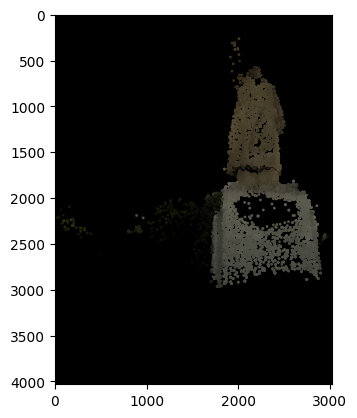

In [15]:
mkp_q = log['keypoints_query']
print(mkp_q.shape)
# 从原图中提取特征点的颜色
origin_image = read_image(image_dir / query)
print(origin_image.shape)
mkp_q_colors = np.array([origin_image[int(mkp_q[i, 1]), int(mkp_q[i, 0])] for i in range(mkp_q.shape[0])])
plt.scatter(mkp_q[:, 0], mkp_q[:, 1], c = mkp_q_colors / 255.0, s=1)
# 设置y轴的方向
plt.gca().invert_yaxis()

plt.imshow(np.zeros((width, height, 3)))
# plt.axis('off')
plt.savefig("origin_disk+lightglue.png", bbox_inches='tight', pad_inches=0, dpi=300)
plt.show()